### BARCODE SCANNER

### Input Data Fetching

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!sudo apt-get install zbar-tools

In [17]:
!pip install loguru
!apt install libzbar0
!pip install pyzbar
!pip install zbar
!pip install kraken

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libzbar0 is already the newest version (0.10+doc-10.1build2).
0 upgraded, 0 newly installed, 0 to remove and 37 not upgraded.
  Using cached zbar-0.10.zip (31 kB)
  ERROR: Failed building wheel for zbar
  Running setup.py clean for zbar
Failed to build zbar
    Running setup.py install for zbar ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-jo5kax6x/zbar_4853423a497d4ee2a3942df73213b1a3/setup.py'"'"'; __file__='"'"'/tmp/pip-install-jo5kax6x/zbar_4853423a497d4ee2a3942df73213b1a3/setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-z16

In [18]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from loguru import logger
img_path = "/content/drive/MyDrive/imagescan/images"
import pyzbar.pyzbar as pyzbar
from pyzbar.pyzbar import ZBarSymbol
from google.colab.patches import cv2_imshow
import imutils
from kraken import binarization
from PIL import Image

In [19]:
class LoadData:
  def __init__(self, file_path):
    self.file_path = file_path
    self.image_dict = dict()

  def process(self):
    for idx, img in enumerate(os.listdir(self.file_path)):
      # self.images.append(cv2.imread(os.path.join(self.file_path,img), cv2.IMREAD_UNCHANGED))
      self.image_dict[idx] = cv2.imread(os.path.join(self.file_path,img), cv2.IMREAD_UNCHANGED)
    logger.warning(f"Loaded: {len(self.image_dict)} images from source")
    return self.image_dict



In [20]:
len(images)

122

### Pre-processing Pipeline

In [21]:
#This will goto Util
def convert_grey(image):
  return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

def morph(image):
  MASK_DILATE_ITER = 1
  MASK_ERODE_ITER = 1
  mask = cv2.dilate(image, None, iterations=MASK_DILATE_ITER)
  mask = cv2.erode(mask, None, iterations=MASK_ERODE_ITER)
  return mask

def sharpen_image(image):
  image_blurred = cv2.GaussianBlur(image, (5, 5), 1)
  image_sharp = cv2.addWeighted(image, 1.5, image_blurred, -0.1, 0)
  return image_sharp

def binarize(image):
  return np.asarray(binarization.nlbin(Image.fromarray(image)))

In [22]:
# This will goto Config
TRANSFORM_MAP = {
    "RGB_to_grey": convert_grey,
    "morph": morph,
    "sharpen": sharpen_image,
    "Binarize": binarize,
}

In [23]:
class PreProcess:
  def __init__(self,images):
    self.images = images
    self.images_transformed = dict()
  
  def transform(self, modes=["RGB_to_grey","Binarize","morph","sharpen"],display=False):
    c = 0
    for idx, image in self.images.items():

      try:
        if not len(image):
          logger.warning("Empty or Corrupted Image File Found and Skipping")
          continue
      except Exception as ex:
        logger.error(f"Error Loading file: {ex}")
        continue
      c += 1
      logger.info(f"Begining Transformation for: {c} Image")
      try:
        mask = image.copy()
        for mode in modes:
          mask = TRANSFORM_MAP[mode](mask)
          logger.info(f"\t\tApplied: {mode} MODE")
        # self.images_transformed.append(mask)
        self.images_transformed[idx] = mask

        if display:
          logger.info(f"\t\tDisplaying Image: {c}")
          plt.imshow(mask)

      except Exception as ex:
        logger.error(f"Failed to operate: {mode} for: {c}")
        continue
    logger.info("Transformation Completed...!!!!")
    return self.images_transformed



### Transformation

### Bar-Code Scanning

In [31]:
!python -m pip install --user opencv-contrib-python

In [36]:
# THIS SHOULD GOTO UTILS
def transform_zbar(image_original, image_processed):
  barcodes = pyzbar.decode(image_processed)
  tr_flag = False
  try:
    for idx, barcode in enumerate(barcodes):
      decoded_value = barcode.data.decode('utf-8')
      logger.info(f"No: {idx+1}, Type: {barcode.type}, Data: {decoded_value}")
      points = np.array([barcode.polygon], np.int32)
      points = points.reshape(-1,1,2)
      cv2.polylines(image_original, [points], True, (255,100,0), 10)
      cv2.putText(image_original, f"{decoded_value}", barcode.polygon[0], cv2.FONT_HERSHEY_SCRIPT_SIMPLEX, 1, (255,100,0), 2)        
      tr_flag = True
  except Exception as ex:
    logger.error(f"Error: {ex} occurred while transforming barcode info for {idx} image")
    return tr_flag
  return tr_flag

def transform_cv(image_original, image_processed): 
  import cv2
  bardet = cv2.legacy_barcode_BarcodeDetector()
  img = image_processed
  ok, decoded_info, decoded_type, corners = bardet.detectAndDecode(img)


In [41]:
#THIS SHOULD GOTO CONFIG
SCANNER_ENGINE = {
    "pyzbar": transform_zbar,
    "opencv": transform_cv,

}

In [ ]:
transform_cv(images[1], processed_images[1])

In [42]:
class ScanBarCode:
  def __init__(self, images):
    self.images = images
    self.scanned_image = dict()
  
  # def _decode_image(self,image):
  #   return pyzbar.decode(image)

  # def _transform(self, image):
  #   barcodes = pyzbar.decode(image)
  #   tr_flag = False
  #   try:
  #     for idx, barcode in enumerate(barcodes):
  #       decoded_value = barcode.data.decode('utf-8')
  #       logger.info(f"No: {idx+1}, Type: {barcode.type}, Data: {decoded_value}")
  #       points = np.array([barcode.polygon], np.int32)
  #       points = points.reshape(-1,1,2)
  #       cv2.polylines(images[idx], [points], True, (100,100,100), 10)
  #       cv2.putText(images[idx], f"{decoded_value}", barcode.polygon[0], cv2.FONT_HERSHEY_SCRIPT_SIMPLEX, 1, (100,100,100), 2)        
  #       tr_flag = True
  #   except Exception as ex:
  #     logger.error(f"Error: {ex} occurred while transforming barcode info for {idx} image")
  #     return tr_flag
  #   return tr_flag


  def fit(self, mode="pyzbar"):
    for idx, image in self.images.items():
      try:
        if not len(image):
          logger.warning("Empty or Corrupted Image File Found and Skipping")
          continue
      except:
        logger.error(f"Error Loading file: {ex}")
        continue
      # barcode = self._decode_image(image)
      # status = self._transform(barcode, image)
      status = SCANNER_ENGINE[mode](images[idx], image)
      if status:
        logger.info(f"Successfully extracted barcode from: {idx} Image")
        self.scanned_image[idx] = image
      else:
        logger.error(f"Failed to extract barcode from: {idx} Image")
    return self.scanned_image
  


### Showing Output

#### TODO: 
           1. TILT DETECTION 
           2. SLIDING WINDOW
           3. SHEER DETECTION
           4. BACKGROUND REMOVAL

In [50]:
logger.info("\nBEGINING FILE LOADING FROM DIRECTORY")
start = time.time()
loader = LoadData(img_path)
images = loader.process()
logger.info(f"\nDATA LOADED SUCCESSFULLY IN: {time.time() - start} Secs")

logger.info("\nPROCESSING IMAGE-SCANNING ENGINE FOR BARCODE DETECTION")
start = time.time()
scanner = ScanBarCode(processed_images)
scanned_images = scanner.fit()
logger.info(f"\nBARCODE DETECTION COMPLETED SUCCESSFULLY IN: {time.time() - start} Secs")
logger.info(f"\nENTIRE PROCESSING TOOK: {time.time() - start_m}")

2022-01-29 09:08:24.858 | INFO     | __main__:<module>:1 - 
BEGINING FILE LOADING FROM DIRECTORY
2022-01-29 09:08:44.407 | WARNING  | __main__:process:10 - Loaded: 122 images from source
2022-01-29 09:08:44.409 | INFO     | __main__:<module>:5 - 
DATA LOADED SUCCESSFULLY IN: 19.545045375823975 Secs
2022-01-29 09:08:44.410 | INFO     | __main__:<module>:7 - 
PROCESSING IMAGE-SCANNING ENGINE FOR BARCODE DETECTION
2022-01-29 09:08:44.480 | INFO     | __main__:transform_zbar:8 - No: 1, Type: CODE128, Data: 23440174641895538169
2022-01-29 09:08:44.486 | INFO     | __main__:fit:40 - Successfully extracted barcode from: 0 Image
2022-01-29 09:08:44.550 | INFO     | __main__:transform_zbar:8 - No: 1, Type: CODE128, Data: 10150174641896340246
2022-01-29 09:08:44.552 | INFO     | __main__:fit:40 - Successfully extracted barcode from: 1 Image
2022-01-29 09:08:45.386 | ERROR    | __main__:fit:43 - Failed to extract barcode from: 2 Image
2022-01-29 09:08:46.212 | ERROR    | __main__:fit:43 - Failed 

In [25]:
import time

start_m = time.time()
#Caller
logger.info("\nBEGINING FILE LOADING FROM DIRECTORY")
start = time.time()
loader = LoadData(img_path)
images = loader.process()
logger.info(f"\nDATA LOADED SUCCESSFULLY IN: {time.time() - start} Secs")


#Caller
logger.info("\nBEGINING PRE-PROCESSING OF IMAGES")
start = time.time()
pre_process = PreProcess(images)
processed_images = pre_process.transform(display=False)
logger.info(f"\nPRE-PROCESSING COMPLETED SUCCESSFULLY IN: {time.time() - start} Secs")

#Caller
logger.info("\nPROCESSING IMAGE-SCANNING ENGINE FOR BARCODE DETECTION")
start = time.time()
scanner = ScanBarCode(processed_images)
scanned_images = scanner.fit()
logger.info(f"\nBARCODE DETECTION COMPLETED SUCCESSFULLY IN: {time.time() - start} Secs")
logger.info(f"\nENTIRE PROCESSING TOOK: {time.time() - start_m}")

2022-01-29 08:34:08.486 | INFO     | __main__:<module>:5 - 
BEGINING FILE LOADING FROM DIRECTORY
2022-01-29 08:34:27.991 | WARNING  | __main__:process:10 - Loaded: 122 images from source
2022-01-29 08:34:27.993 | INFO     | __main__:<module>:9 - 
DATA LOADED SUCCESSFULLY IN: 19.50421142578125 Secs
2022-01-29 08:34:28.002 | INFO     | __main__:<module>:13 - 
BEGINING PRE-PROCESSING OF IMAGES
2022-01-29 08:34:28.003 | INFO     | __main__:transform:18 - Begining Transformation for: 1 Image
2022-01-29 08:34:28.010 | INFO     | __main__:transform:23 - 		Applied: RGB_to_grey MODE
2022-01-29 08:34:29.218 | INFO     | __main__:transform:23 - 		Applied: Binarize MODE
2022-01-29 08:34:29.222 | INFO     | __main__:transform:23 - 		Applied: morph MODE
2022-01-29 08:34:29.232 | INFO     | __main__:transform:23 - 		Applied: sharpen MODE
2022-01-29 08:34:29.234 | INFO     | __main__:transform:18 - Begining Transformation for: 2 Image
2022-01-29 08:34:29.238 | INFO     | __main__:transform:23 - 		Appl

0 --------


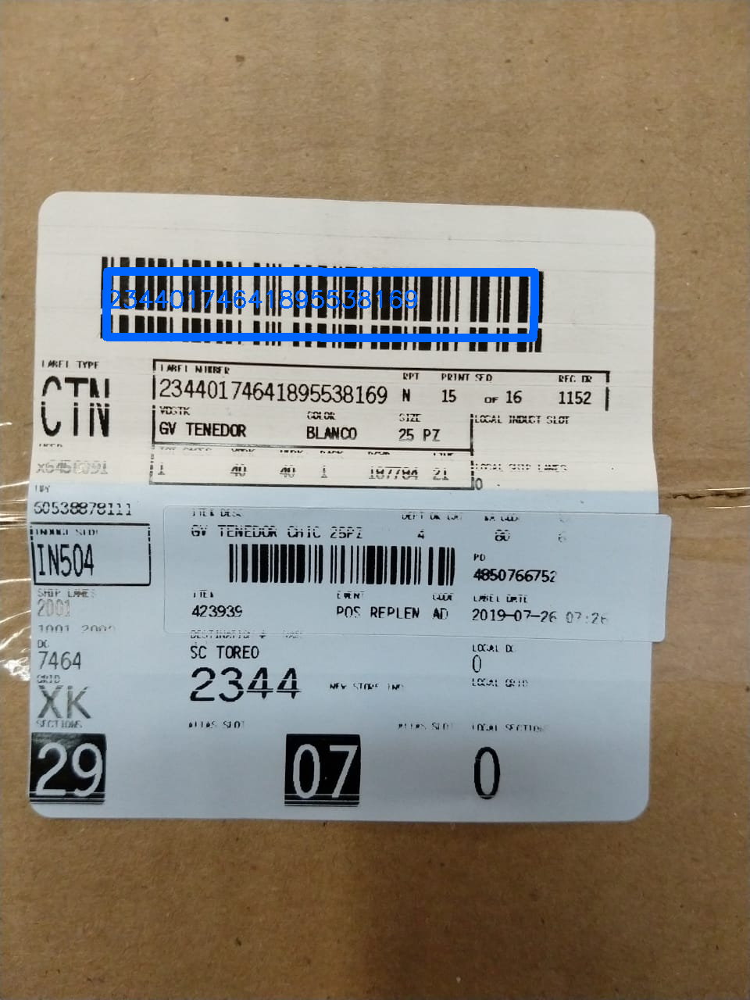

1 --------


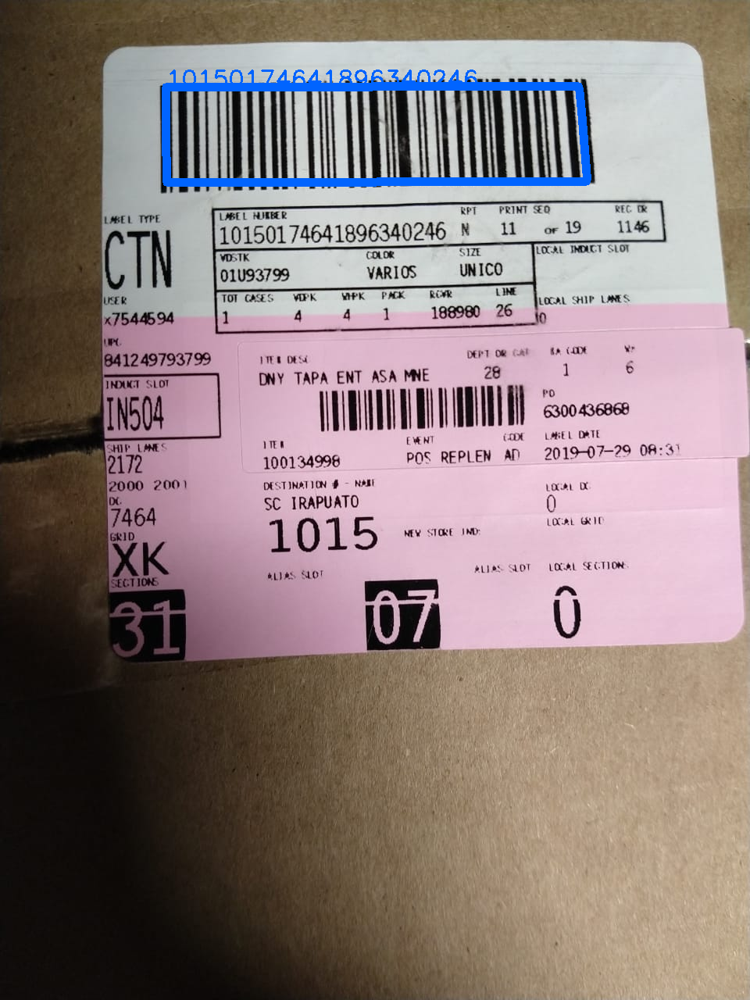

2 --------


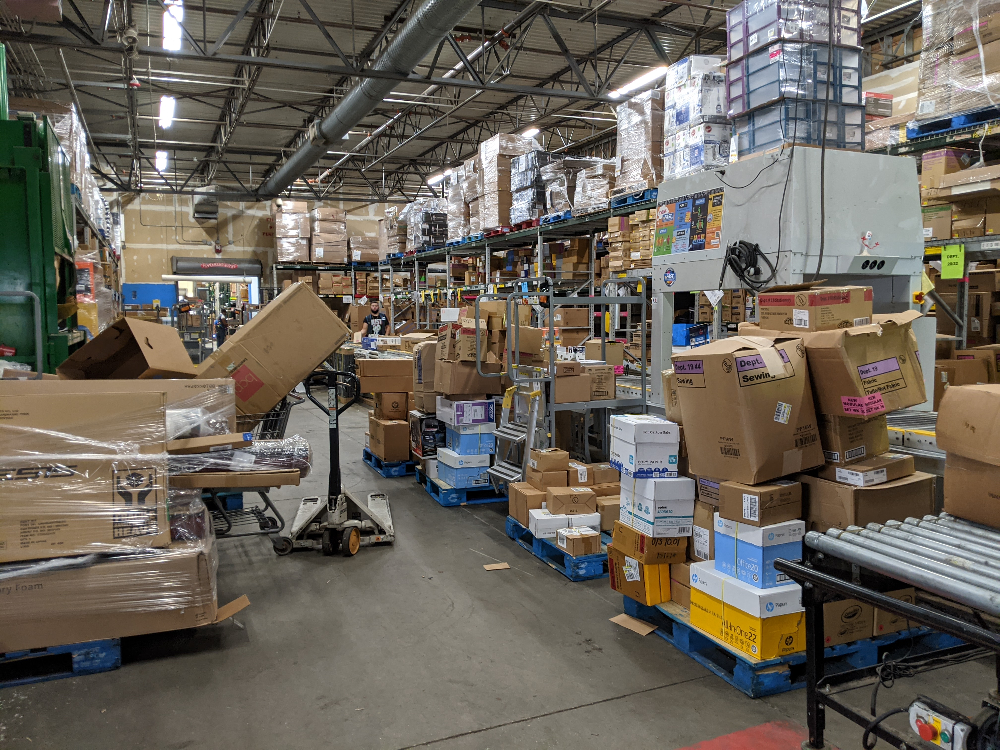

3 --------


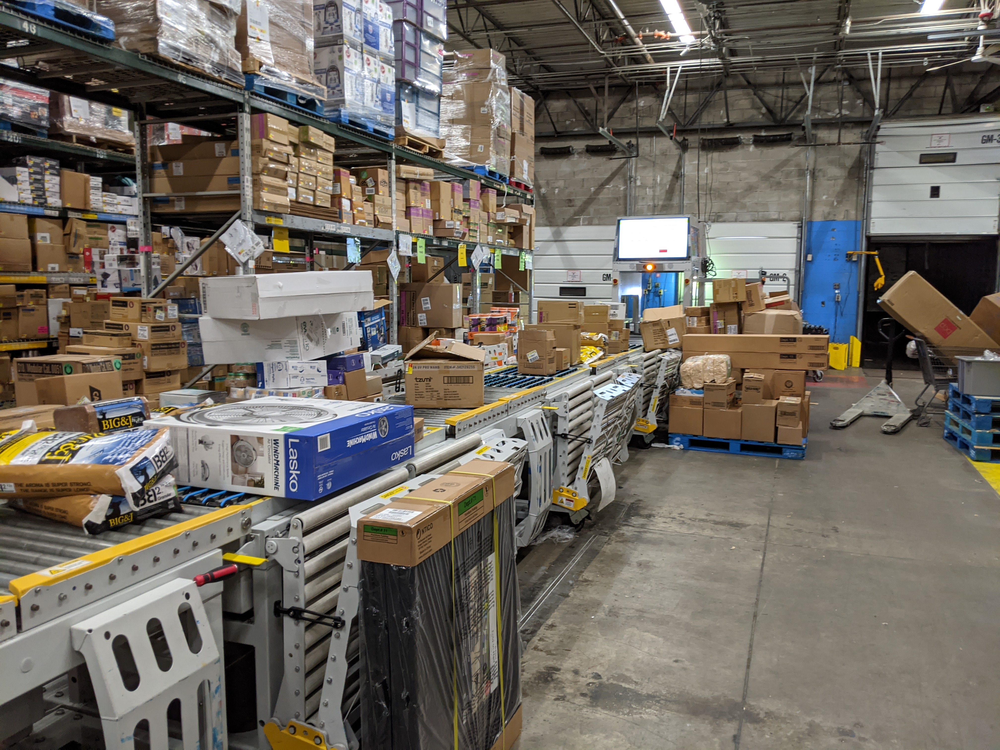

4 --------
Buffered data was truncated after reaching the output size limit.

In [53]:
for id, img in images.items():
  try:
    if not len(img):
      logger.warning("Empty or Corrupted Image File Found and Skipping")
      continue
  except Exception as ex:
    logger.error(f"Error Loading file: {ex}")
    continue
  print(id,'--------')
  cv2_imshow(img)

### Experiment

In [ ]:

def my_func(image_i):
  # load the image and convert it to grayscale
  image = image_i
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  # compute the Scharr gradient magnitude representation of the images
  # in both the x and y direction using OpenCV 2.4
  ddepth = cv2.cv.CV_32F if imutils.is_cv2() else cv2.CV_32F
  gradX = cv2.Sobel(gray, ddepth=ddepth, dx=1, dy=0, ksize=-1)
  gradY = cv2.Sobel(gray, ddepth=ddepth, dx=0, dy=1, ksize=-1)
  # subtract the y-gradient from the x-gradient
  gradient = cv2.subtract(gradX, gradY)
  gradient = cv2.convertScaleAbs(gradient)

  # blur and threshold the image
  blurred = cv2.blur(gradient, (9, 9))
  (_, thresh) = cv2.threshold(blurred, 225, 255, cv2.THRESH_BINARY)

  # construct a closing kernel and apply it to the thresholded image
  kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (21, 7))
  closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

  # perform a series of erosions and dilations
  closed = cv2.erode(closed, None, iterations = 1)
  closed = cv2.dilate(closed, None, iterations = 1)

  # find the contours in the thresholded image, then sort the contours
  # by their area, keeping only the largest one
  cnts = cv2.findContours(closed.copy(), cv2.RETR_EXTERNAL,
    cv2.CHAIN_APPROX_SIMPLE)
  cnts = imutils.grab_contours(cnts)
  c = sorted(cnts, key = cv2.contourArea, reverse = True)[0]
  # compute the rotated bounding box of the largest contour
  rect = cv2.minAreaRect(c)
  box = cv2.cv.BoxPoints(rect) if imutils.is_cv2() else cv2.boxPoints(rect)
  box = np.int0(box)
  # draw a bounding box arounded the detected barcode and display the
  # image
  cv2.drawContours(image, [box], -1, (0, 255, 0), 3)
  # plt.imshow(image)
  return image



In [ ]:
len(images)

122

In [ ]:
li = list()
for img in scanned_images:
  try:
    if not len(img):
      logger.warning("Empty or Corrupted Image File Found and Skipping")
      continue
  except:
    continue
  img = my_func(img)
  S = ScanBarCode([img])
  li.append(S.fit())

In [ ]:
cv2_imshow(li[0][0])

IndexError: ignored

In [ ]:
li.shape

AttributeError: ignored

In [ ]:
len(li)

118

In [ ]:
cv2_imshow(img)

AttributeError: ignored

In [ ]:
import numpy as np
import cv2

image = images[0]
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# equalize lighting
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
gray = clahe.apply(gray)

# edge enhancement
edge_enh = cv2.Laplacian(gray, ddepth = cv2.CV_8U, 
                         ksize = 3, scale = 1, delta = 0)
cv2_imshow(edge_enh)

retval = cv2.imwrite("edge_enh.jpg", edge_enh)

# bilateral blur, which keeps edges
blurred = cv2.bilateralFilter(edge_enh, 13, 50, 50)

# use simple thresholding. adaptive thresholding might be more robust
(_, thresh) = cv2.threshold(blurred, 55, 255, cv2.THRESH_BINARY)
cv2_imshow(thresh)

retval = cv2.imwrite("thresh.jpg", thresh)

# do some morphology to isolate just the barcode blob
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
closed = cv2.erode(closed, None, iterations = 4)
closed = cv2.dilate(closed, None, iterations = 4)
cv2_imshow(closed)

retval = cv2.imwrite("closed.jpg", closed)

# find contours left in the image
# (_, cnts,_) = cv2.findContours(closed.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# c = sorted(cnts, key = cv2.contourArea, reverse = True)[0]
c = cv2.findContours(closed.copy(), cv2.RETR_EXTERNAL,
cv2.CHAIN_APPROX_SIMPLE)
c = imutils.grab_contours(c)
c = sorted(c, key = cv2.contourArea, reverse = True)[0]
rect = cv2.minAreaRect(c)
box = np.int0(cv2.boxPoints(rect))
cv2.drawContours(image, [box], -1, (0, 255, 0), 3)
print(box)
cv2_imshow(image)

retval = cv2.imwrite("found.jpg", image)

Output hidden; open in https://colab.research.google.com to view.